----------------------
# Change Log
* QH 11222020
    * Modified from Hull_HW12.py in submissions directory

* QH 11132020
    * Modified from Week12_Reanalysis_Netcdf_starter.py in course materials

* QH 11142020
    * Modified from Hull_HW_12_Week12_Forecast_Netcdf_starter.py in Week12 HW dir
    * Modified from Hull_HW10.py in submissions dir
    * Modified form Hull_HW12_MAP.py in Week12 HW dir

----------------------

## Grade 
6/6 - Great job!  I realy like the organization and the narration, very easy to follow especially with the outline at the top. I also really like how you define global variables early on in the script. 

Notes for next time: 
- I'm not sure you need the change log at the top?
- Consider getting all of your functions into a separate file. 
- Include paths and file names in your set of global variables at the top. 


# Introduction

This Jupyter notebook is for the second code submission in HAS Tools, Fall 2020. It's function is to assemble hydrologic and meterological data to create streamflow forecasts for streamflow at Verde River in central Arizona. See the outline below for a detailed description of the code utilized by this notebook

# Discussion of how forecast has evolved through time
* Elementary Forecasts (Weeks 1-2) were just guesses, really
* Beginner Forecasts (Weeks 3-4) involved taking weekly averages of years qualitatively tagged as 'dry' (for example > 2010) and adjusting them slightly to use for predictions 
* Lower Intermediate Forecasts (Week 5) was my first try at using a regression (but not autoregression) technique
* Upper Intermediate Forecasts (Weeks 6-7) involved testing out autoregression techniques
* Lower Advanced Forecasts (Weeks 8-12) have involved refining the autoregression technique by adding other predictors (temperature and preciptiation), as well as using normalization, scaling, and transformation techniques available through sklearn and simple log transformation

# Outline of 'how' I generate the forecast
1. Define modules
2. Define globals
3. Import forecast 'T' and 'P' - Virtual Crossing
4. Import and assemble historical flow - USGS
5. Import and assemble historical 'T' and 'P' - Mesonet
6. Resample Datasets
7. Cross Plots Before Normalization
8. Subset, normalize, and lag datasets
9. Cross Plots After Normalization
10. Build and Export an Auto-Regressive Model
11. Show a map of the study area

## 1. Define Modules
* Note that forecast-specific functions are located in the script `Hull_HW13_fxns.py` within this directory

In [1]:
# generic
import pandas as pd
import matplotlib.pyplot as plt
import os
import numpy as np
import Hull_HW13_fxns as fn
from pandas.plotting import scatter_matrix

# for scaling
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import PowerTransformer

# for mapping
import geopandas as gpd
import fiona
from shapely.geometry import Point
from pprint import pprint

## 2. Define Globals
* Including the max and min dates used to extract data via API from data source, as well as the date ranges used to run regression

In [2]:
start = '2010-02-01'
end = '2020-12-31'

## 3. Import forecast 'T' and 'P' - Virtual Crossing
* Note that a limited number of 'free' API queries are allowed per day (~1000)
* It may be necessary for user to change 'vskey' by creating a new virtual crossing username and locating account key at this website: https://www.visualcrossing.com/weather/weather-data-services#/accountdetails

In [3]:
# keys for accessing forecast
vskey = 'SL1F2XI46LCJAUMYAGG6GMV5B'
vslat = str(34.448333)
vslong = str(-111.789167)
vsurl = 'https://weather.visualcrossing.com/VisualCrossingWebServices/rest/services/weatherdata/forecast?locations='+vslat+','+vslong+'&aggregateHours=24&unitGroup=us&shortColumnNames=false&contentType=csv&key='+vskey

# access forecast
vc_forecast_df = pd.read_csv(vsurl,
                             parse_dates=['Date time'],
                             index_col='Date time'
                             )

## 4. Import and assemble historical flow - USGS

In [4]:
# adjust path as necessary
site = '09506000'
url = "https://waterdata.usgs.gov/nwis/dv?cb_00060=on" \
      "&format=rdb&site_no="+site+"&referred_module=sw&" \
      "period=&begin_date="+start+"&end_date="+end

# read in data
flow_df = pd.read_table(url, sep='\t', skiprows=30,
                        names=['agency_cd', 'site_no',
                               'datetime', 'flow', 'code'],
                        parse_dates=['datetime'],
                        index_col='datetime'
                        )

# re-instantiate data with just the flow values
flow_df = np.log(flow_df[['flow']])
# flow_df = flow_df[['flow']]
flow_df.index = flow_df.index.tz_localize(tz="UTC")

## 5. Import and assemble historical 'T' and 'P' - Mesonet

In [5]:
# 1) quickly look for nearby stations
# 1a) Token
# # IMPORTNAT: I overused my token ('a836998da79e4faeac2bf7f5cda57a6e')
# # so I am only able to use the demo token below
mytoken = 'demotoken'
# 1b) 'Base' URL
base_url = "https://api.synopticdata.com/v2/stations/metadata"
# 1c) nearby stations
# look for 10 nearest stations within 10 miles of usgs gaging station
args = {
       'token': mytoken,
       'radius': '34.448333,-111.789167,10',
       'limit': '10',
       }
# 1d) Extract station synoptic data
stationDict = fn.extractmasonet(base_url, args)

# 2) Extract time series data from active sites
# 2a) 'Base' URL
base_url_in = "https://api.synopticdata.com/v2/stations/timeseries"
arg_vars = 'air_temp,precip_accum'
arg_units = 'temp|F,precip|mm'
args_in = {
        'start': start.replace('-', '')+'0000',
        'end': end.replace('-', '')+'0000',
        'obtimezone': 'UTC',
        'vars': arg_vars,
        'stids': '',
        'units': arg_units,
        'token': mytoken}
station_condition_in = 'ACTIVE'
station_name_in = 'QVDA3'

masonet_df = fn.assemble_data_masonet(base_url_in, args_in, stationDict,
                                      data_join=pd.DataFrame(index=flow_df.index),
                                      station_name=station_name_in)

full url = https://api.synopticdata.com/v2/stations/metadata?token=demotoken&radius=34.448333,-111.789167,10&limit=10 

KLHU INACTIVE {'start': None, 'end': None} 

QVDA3 ACTIVE {'start': '1997-01-01T00:00:00Z', 'end': '2020-11-19T21:05:00Z'} 

full url = https://api.synopticdata.com/v2/stations/timeseries?start=201002010000&end=202012310000&obtimezone=UTC&vars=air_temp,precip_accum&stids=QVDA3&units=temp%7CF,precip%7Cmm&token=demotoken 

WCLA3 INACTIVE {'start': '2015-10-20T17:59:00Z', 'end': '2019-10-15T18:45:00Z'} 

C4534 ACTIVE {'start': '2005-10-20T00:00:00Z', 'end': '2020-11-19T21:00:00Z'} 

FCSA3 ACTIVE {'start': '2013-03-16T00:00:00Z', 'end': '2020-11-19T20:30:00Z'} 

QVDA3


## 6. Resample Datasets
* This resamples the precip, temperature, and flow data from USGS, masonet, and vc_crossing

In [6]:
# sumarize flow, precip, air temp on weekly basis
# # resample
# # # flow
flow_df = flow_df.resample("W").mean()
# # # precip and temp masonet
masonet_df['precip_accum_set_1'] = masonet_df['precip_accum_set_1'] \
                                - masonet_df['precip_accum_set_1'].shift(1)
masonet_df['precip_accum_set_1'].where(
            masonet_df['precip_accum_set_1'] > 0, inplace=True)
p_masonet_df = pd.DataFrame(
                            masonet_df['precip_accum_set_1'].
                            resample("W").sum()
                            )

p_masonet_df = p_masonet_df**(1/3)

t_masonet_df = pd.DataFrame(
                            masonet_df['air_temp_set_1'].
                            resample("W").mean()
                            )
# # # precip and temp forecasts
p_vc_forecast_df = pd.DataFrame(
                                vc_forecast_df['Precipitation'].
                                resample("W").sum()
                                )
t_vc_forecast_df = pd.DataFrame(
                                vc_forecast_df['Temperature'].
                                resample("W").mean()
                                )

## 7. Cross Plots Before Normalization
* This shows how well correlated the temperature, precipitation, and flow data are from Masonet and USGS, respectively. Before 'normalization' (scaling from 0 to 1). This figure shows that the relationships between flow, precipitation, and tempreature are difficult to discern because of the non-normal distribution of flow and precipitation (heavily skewed right)

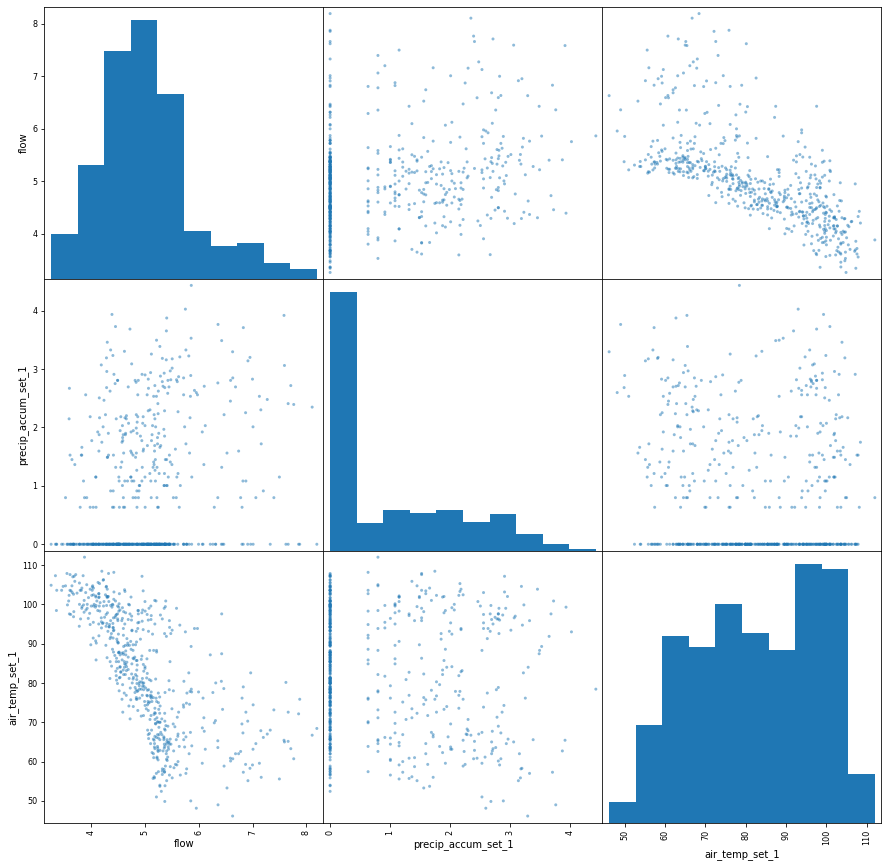

In [7]:
t = pd.concat([flow_df, p_masonet_df, t_masonet_df], axis=1)
scatter_matrix(t, alpha=0.5, figsize=(15,15))
plt.show()
del(t)

## 8. Subset, normalize, and lag datasets
* This will lag the datasets by one week (for auto-regression), as well as normalize the data to values ~ between -1 and 1 and using the robust scaler

In [8]:
# # documentation on the normalization function
help(fn.norm_it)

Help on function norm_it in module Hull_HW13_fxns:

norm_it(startdate, enddate, dfin, dfname, l_back=1, toscale=True, cscaler=MinMaxScaler())
    This function noramlizes a column of data from a pandas dataframe
    using the predefined scaler feature of sklearn
    to create a ~ normal distribution
    and allow for better fitting between different types of variables
    in a multivariable regression
    
    It also lags the data by a specified number of weeks (look_back)
    
    Takes:
    A start and end date (strings)
        startdate =
        enddate =
    A dataframe (pandas)
        dfin =
    The name of a single column of data to normalize (string)
        dfname =
    A specified number of look backs (integer)
        l_back = [1]
    A Boolean to decide if to scale the data (i.e. if not desired or already done)
        toscale = [True]
    An optional scaler
        cscaler = [MinMaxScaler(feature_range=(0, 1))]
    
    Returns:
    The dataframe with a column of normal

In [8]:
# # subset, normalize, and lag
flow_df, scale1 = fn.norm_it(start, end, flow_df, 'flow', l_back=1,
                             cscaler=RobustScaler())
p_masonet_df, scale2 = fn.norm_it(start, end, p_masonet_df,
                                  'precip_accum_set_1', l_back=1,
                                  cscaler=RobustScaler())
t_masonet_df, scale3 = fn.norm_it(start, end, t_masonet_df,
                                  'air_temp_set_1', l_back=1,
                                  cscaler=RobustScaler())

## 9. Cross Plots After Normalization
* This shows how well correlated the temperature, precipitation, and flow data are from Masonet and USGS, respectively. After 'normalization' (scaling ~ 1 to 1) and transformation (to ~ gaussian). Additionally, includes lagged comparison (-1 week). We see that the relationships between flow and temperature are much more concrete, although precipitation leaves something to be desired...

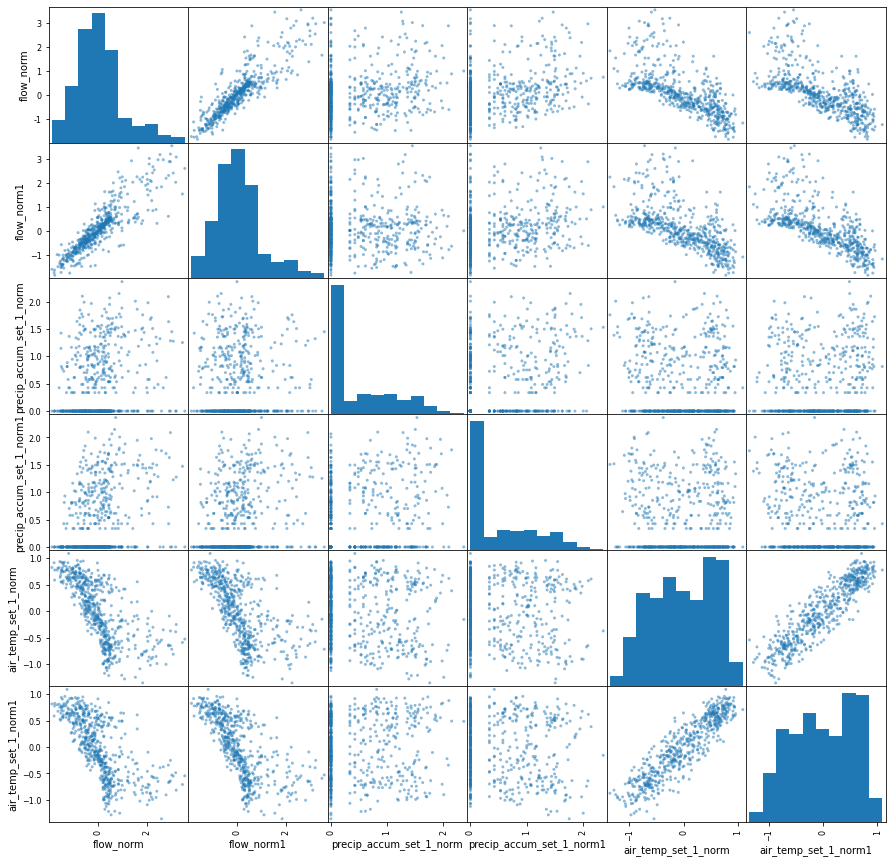

In [9]:
t = pd.concat([flow_df['flow_norm'], flow_df['flow_norm1'], p_masonet_df['precip_accum_set_1_norm'], p_masonet_df['precip_accum_set_1_norm1'], 
t_masonet_df['air_temp_set_1_norm'], t_masonet_df['air_temp_set_1_norm1']], axis=1)
scatter_matrix(t, alpha=0.5, figsize=(15,15))
plt.show()
del(t)

## 10. Build and Export an Auto-Regressive Model
* This part of the code creates an auto-regressive model using the raw temperature, flow, and precip data to create a prediction for our two week and sixteen week forecasts for flow

In [10]:
# Step 1: pick regression variables
# Step 2: pick periods of regression (train)
# Step 3: subset data to regression (trains)
t = pd.concat([flow_df, p_masonet_df, t_masonet_df], axis=1)
t = fn.clean_dataset(t)
t = t.reset_index()

# Step 4: Fit a linear regression to 'train' data using sklearn
# for (i) 1 and 2 week prediction
# # predictive variables (all normalized between 0 and 1) =
# # # 1) 'flow_norm_tm1' (log of flow last week)
# # # 2) 'air_temp_set_1_norm' (mean weekly temperature, over 10 years)
# # # 2) 'precip_accum_set_1_norm' (sum weekly preciptation, over 10 years)
x = t[['flow_norm1',
       'air_temp_set_1_norm',
       'precip_accum_set_1_norm']]
# # dependent variable = 'flow' (log of flow this week)
y = t['flow_norm']
# # use predifined function (makemodel) to generate model
m, s = fn.makemodel(x, y)

# Step 5: Make a prediction for (i) 1 and 2 week,

# (i) week prediction
# set lastweekflow data as most recent week of data
x_lastweekflow = t['flow_norm'].iloc[-1]
# # set last week precip variation and temperature
# x_lastweektemp = t['air_temp_set_1_norm'].iloc[-1]
# x_lastweekprecip = t['precip_accum_set_1_norm'].iloc[-1]

print("AR Week 1 and 2 forecast prediction:")

for i in range(2):
    # set last week precip variation and temperature
    x_lastweekprecip = scale2.transform(p_vc_forecast_df['Precipitation'].
                                        iloc[i].reshape(1, -1))
    x_lastweektemp = scale3.transform(t_vc_forecast_df['Temperature'].
                                      iloc[i].reshape(1, -1))
    # set the week i name
    name = "Week {0}:".format(i+1)
    # predict week i flow, using flow, temperature, and precip
    x_lastweekflow = m.intercept_ + m.coef_[0] * x_lastweekflow \
                                  + m.coef_[1] * x_lastweektemp \
                                  + m.coef_[2] * x_lastweekprecip
    # print week, flow (forecast), precip and temp (predictive variables)
    print(name, "Flow (cfs) =",
                np.round(np.exp(fn.denorm_it(x_lastweekflow, scale1)), 2),
                "Precip (mm)=",
                np.round(fn.denorm_it(x_lastweekprecip, scale2)**3, 2),
                "Temp (deg F)=",
                np.round(fn.denorm_it(x_lastweektemp, scale3), 2))


print("\n")

# Step 4: Fit a linear regression to 'train' data using sklearn
# for (ii) semester forecast
x = t[['flow_norm1']]
# # dependent variable = 'flow' (log of flow this week)
y = t['flow_norm']
# # use predifined function (makemodel) to generate model
m, s = fn.makemodel(x, y)

# Step 5: Make a prediction for (ii) semester forecast

# (ii) semester forecast
# set lastweek as first week of semester
x_lastweekflow = t['flow_norm'][
                            (t['datetime'] >= '2020-08-20') &
                            (t['datetime'] < '2020-08-27')
                            ].values

print("AR Semester forecast prediction:")

for i in range(16):
    name = "Week {0}:".format(i+1)
    # predict week i flow, using flow, temperature, and precip
    x_lastweekflow = m.intercept_ + m.coef_[0] * x_lastweekflow
    # print week, flow (forecast)
    print(name, "Flow (cfs) =",
                np.round(np.exp(fn.denorm_it(x_lastweekflow, scale1)), 2))

AR Week 1 and 2 forecast prediction:
Week 1: Flow (cfs) = [[190.83]] Precip (mm)= [[0.]] Temp (deg F)= [[48.9]]
Week 2: Flow (cfs) = [[233.91]] Precip (mm)= [[0.]] Temp (deg F)= [[44.24]]


AR Semester forecast prediction:
Week 1: Flow (cfs) = [[44.06]]
Week 2: Flow (cfs) = [[51.29]]
Week 3: Flow (cfs) = [[58.58]]
Week 4: Flow (cfs) = [[65.8]]
Week 5: Flow (cfs) = [[72.84]]
Week 6: Flow (cfs) = [[79.62]]
Week 7: Flow (cfs) = [[86.06]]
Week 8: Flow (cfs) = [[92.12]]
Week 9: Flow (cfs) = [[97.78]]
Week 10: Flow (cfs) = [[103.01]]
Week 11: Flow (cfs) = [[107.81]]
Week 12: Flow (cfs) = [[112.19]]
Week 13: Flow (cfs) = [[116.17]]
Week 14: Flow (cfs) = [[119.77]]
Week 15: Flow (cfs) = [[123.01]]
Week 16: Flow (cfs) = [[125.92]]


## 11. Show a map of study area
* Note that this will only work if data are accessible locally. They are too large to put onto github. In the expectation that they are not available locally, the map that this script creates is below.
* This map shows the southern direction of flow along the Verde River to the Salt River, as well as the locaiton of other USGS stream gages, groundwater data, etc...
![](assets/Week13_Map.png)

In [17]:
# Mapping-specific function
def add_pt_gdf(point_l, crs_i, gpd_in, nm_pts):
    """The function reads in a numpy array of one or multiple spatial data values
    with the intention of converting that into a pandas dataframe
    and then appending this to the end of an existing pandas geodataframe

    inputs:
    point_l = a 2-D numpy array of spatial data values (like easting, northing)
        or (like lat, long)
    crs_in = the coordinate system of the dataframe, a crs object
    gpd_in = the pandas dataframe containing geodataframe info
    nm_pts = the name you would like to give the new row in the dataframe

    output:
    the inputted pandas dataframe container of gdp and other info
    with a new record containing a gdp oflat / long data
    """

    # make these into spatial features
    point_geom = [Point(xy) for xy in point_l]

    # create point_df geodataframe
    point_df = gpd.GeoDataFrame(point_geom, columns=['geometry'],
                                crs=crs_i)

    # add to gpd_df
    gpd_in = gpd_in.append({'names': nm_pts,
                            'file': '', 'gpd': point_df},
                           ignore_index=True)

    return gpd_in

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - NAD83
- bounds: (167.65, 14.92, -47.74, 86.46)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - NAD83
- bounds: (167.65, 14.92, -47.74, 86.46)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - NAD83
- bounds: (167.65, 14.92, -47.74, 86.46)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axi

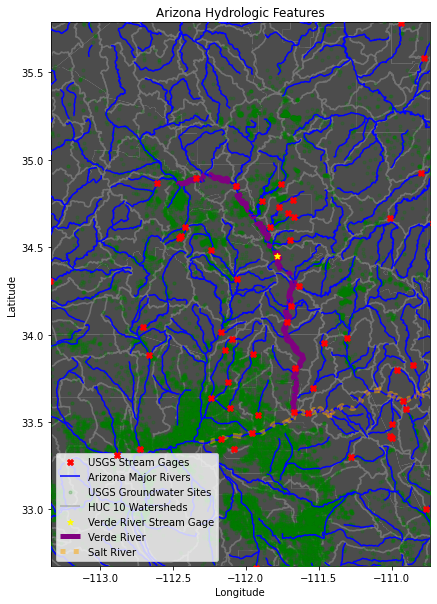

In [18]:
# 1) create a df of files, filepath, and name
filepath = '../../../spatial_data_nongit/'
gpd_df = pd.DataFrame(columns=['names', 'file', 'gpd'])

names = ['gages', 'rivers', 'gwsi', 'huc', 'az']

gpd_df['names'] = names

filenames = ['gagesII_9322_point_shapefile/gagesII_9322_sept30_2011.shp',
             'USA_Rivers_and_Streams-shp/'
             '9ae73184-d43c-4ab8-940a-c8687f61952f2020328-1-r9gw71.0odx9.shp',
             'GWSI_ZIP_10162020/Shape/GWSI_SITES.shp',
             'Shape/WBDHU10.shp',
             'tl_2016_04_cousub/tl_2016_04_cousub.shp']

gpd_df['file'] = filenames
gpd_df['file'] = filepath + gpd_df['file']

# Import data into df and add to dataframe
for i in range(len(gpd_df)):
    gpd_df.iat[i, 2] = gpd.read_file(gpd_df['file'].iloc[i])


# 2) Add some points
# Stream gauge:  34.44833333, -111.7891667
point_list = np.array([[-111.7891667, 34.44833333]])

# extract crs from huc (desired to apply)
crs_in = gpd_df['gpd'].iloc[
                            gpd_df.index[
                                         gpd_df['names'
                                                ] == 'huc'].tolist()[0]
                            ].crs

# add a line containing point_list to gpd_df including data frame of points
gpd_df = add_pt_gdf(point_list, crs_in, gpd_df, 'points_df')

# 3) fix any crs issues
# 4) Clip data extent for all layers based on extent of arizona

# clip set
clip_set = gpd_df['gpd'].iloc[gpd_df.index[gpd_df['names'] ==
                              'az'].tolist()[0]]

# crs set
# exract crs to set all to (from gages)
crs_set = clip_set.crs

# look through all gdf and (a) fix crs issues and (b) clip domains
for i in range(len(gpd_df)):
    gpd_df['gpd'].iloc[i].to_crs(crs_set, inplace=True)
    pprint(gpd_df['gpd'].iloc[i].crs)
    gpd_df.iat[i, 2] = gpd.clip(gpd_df['gpd'].iloc[i], clip_set, False)


# 6) Make a map of just Verde River Area
extent = gpd_df['gpd'].iloc[1][gpd_df['gpd'].iloc[1]['Name'] == 'Verde River']
salt = gpd_df['gpd'].iloc[1][gpd_df['gpd'].iloc[1]['Name'] == 'Salt River']

rangef = (extent.total_bounds[2] - extent.total_bounds[0])
# clip extent
xmin, xmax, ymin, ymax = extent.total_bounds[0]-rangef, \
                         extent.total_bounds[2]+rangef, \
                         extent.total_bounds[1]-rangef, \
                         extent.total_bounds[3]+rangef

# create plot
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

colorList = ['red', 'blue', 'green', 'grey', 'black', 'yellow']
alphaList = [1, 1, 0.2, 0.5, 0.7, 1]
zorderList = [6, 4, 3, 2, 1, 7]
nameList = ['USGS Stream Gages', 'Arizona Major Rivers',
            'USGS Groundwater Sites', 'HUC 10 Watersheds',
            'AZ', 'Verde River Stream Gage']
markerList = ['X', '_', '.', '_', '_', '*']

# loop through all gdps:
for i in range(len(gpd_df)):
    if gpd_df['names'].iloc[i] == 'huc':
        gpd_df['gpd'].iloc[i].boundary.plot(ax=ax,
                                            label=nameList[i],
                                            zorder=zorderList[i],
                                            edgecolor=colorList[i],
                                            alpha=alphaList[i])

    else:
        gpd_df['gpd'].iloc[i].plot(ax=ax,
                                   label=nameList[i],
                                   zorder=zorderList[i],
                                   color=colorList[i],
                                   alpha=alphaList[i],
                                   marker=markerList[i]
                                   )

# plot just Verde River
extent.plot(ax=ax,
            label='Verde River',
            zorder=5,
            color='purple',
            linestyle='-.',
            linewidth=5)

# plot just Salt River
salt.plot(ax=ax,
          label='Salt River',
          zorder=5,
          color='orange',
          linestyle=':',
          linewidth=5,
          alpha=0.5)

ax.set_title('Arizona Hydrologic Features')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.legend(loc='lower left')
plt.show()
